In [1]:
from __future__ import print_function, division
import os
import torch
import pandas as pd
from skimage import io, transform
import numpy as np
import matplotlib.pyplot as plt

# Ignore warnings
import warnings
warnings.filterwarnings("ignore")

plt.ion()   # interactive mode

In [2]:
%load_ext autoreload
%autoreload 2

In [3]:
import sys
sys.path.insert(0, '../')

In [4]:
os.environ['CUDA_VISIBLE_DEVICES'] = '0,2'

# Training using the ResNet topology

In [5]:
from cpe775.networks.resnet import resnet18

In [6]:
net = resnet18(in_shape=(-1, 1, 224, 224), out_shape=(-1, 68, 2))

## Loading the dataset and splitting between train and valid

In [7]:
from cpe775.dataset import FaceLandmarksDataset, CroppedFaceLandmarksDataset
from torch.utils.data.sampler import SubsetRandomSampler
from torchvision.transforms import Compose
from cpe775.transforms import ToTensor, CropFace, ToGray, RandomHorizontalFlip, ToPILImage, RandomCrop, CenterCrop

In [8]:
batch_size = 128
random_seed = 42
valid_size = 0.2
shuffle = True

In [9]:
train_transforms = Compose([
                   ToPILImage(),
                   RandomCrop((224,224)),
                   RandomHorizontalFlip(),
                   ToGray(),
                   ToTensor()
                 ])

transforms = Compose([
                   ToPILImage(),
                   CenterCrop((224,224)),
                   ToGray(),
                   ToTensor()
                 ])

In [10]:
# load the dataset
train_dataset = CroppedFaceLandmarksDataset(data_file='../data/train.npz',
                                            transform=train_transforms)
valid_dataset = CroppedFaceLandmarksDataset(data_file='../data/train.npz',
                                            transform=transforms)

num_train = len(train_dataset)
indices = list(range(num_train))
split = int(np.floor(valid_size * num_train))

if shuffle == True:
    np.random.seed(random_seed)
    np.random.shuffle(indices)

train_idx, valid_idx = indices[split:], indices[:split]

train_sampler = SubsetRandomSampler(train_idx)
valid_sampler = SubsetRandomSampler(valid_idx)

train_loader = torch.utils.data.DataLoader(train_dataset, 
                batch_size=batch_size, sampler=train_sampler, num_workers=4)

valid_loader = torch.utils.data.DataLoader(valid_dataset, 
                batch_size=batch_size, sampler=valid_sampler, num_workers=4)

## Creating the model

In [11]:
net = torch.nn.DataParallel(net)
net = net.cuda()

In [12]:
np.sum([v.numel() for v in net.parameters()])

718072

## Creating the loss function

In [13]:
import torch
from cpe775.criterion import NRMSELoss
from cpe775.model import Model
from cpe775 import callbacks

In [14]:
criterion = NRMSELoss()
criterion = criterion.cuda()

In [15]:
optimizer = torch.optim.SGD(net.parameters(), 0.1, momentum=0.9)
model = Model(net, criterion=criterion)
model.set_optimizer(optimizer)

## Training

In [16]:
from torch.optim.lr_scheduler import MultiStepLR
from cpe775 import metrics

In [17]:
callback_list = [
        callbacks.Progbar(print_freq=40),
        callbacks.ModelCheckpoint('../results/resnet/resnet-18-1c-nrmse.pth.tar', 'val_loss', mode='min'),
        callbacks.LearningRateScheduler(MultiStepLR(optimizer, milestones=[750,900], gamma=0.1))
    ]

In [18]:
model.fit_loader(train_loader, 1000, val_loader=valid_loader,
                 callback=callbacks.Compose(callback_list), metrics={'nrmse': NRMSELoss(weight=68)})

Epoch: [0][0/20]	Time 6.539 (6.539)	Data 0.186 (0.186)	Train Loss 2.985 (2.985)	Train Nrmse 202.994 (202.994)	
Val: [0/5]	Time 0.244 (0.244)	Data 0.205 (0.205)	Val Loss 7.851 (7.851)	Val Nrmse 533.897 (533.897)	
Epoch: [1][0/20]	Time 0.272 (0.272)	Data 0.221 (0.221)	Train Loss 0.533 (0.533)	Train Nrmse 36.266 (36.266)	
Val: [0/5]	Time 0.232 (0.232)	Data 0.210 (0.210)	Val Loss 1.324 (1.324)	Val Nrmse 90.038 (90.038)	
Epoch: [2][0/20]	Time 0.314 (0.314)	Data 0.239 (0.239)	Train Loss 0.408 (0.408)	Train Nrmse 27.730 (27.730)	
Val: [0/5]	Time 0.276 (0.276)	Data 0.236 (0.236)	Val Loss 0.298 (0.298)	Val Nrmse 20.269 (20.269)	
Epoch: [3][0/20]	Time 0.278 (0.278)	Data 0.195 (0.195)	Train Loss 0.393 (0.393)	Train Nrmse 26.729 (26.729)	
Val: [0/5]	Time 0.256 (0.256)	Data 0.202 (0.202)	Val Loss 0.287 (0.287)	Val Nrmse 19.505 (19.505)	
Epoch: [4][0/20]	Time 0.318 (0.318)	Data 0.266 (0.266)	Train Loss 0.364 (0.364)	Train Nrmse 24.748 (24.748)	
Val: [0/5]	Time 0.266 (0.266)	Data 0.234 (0.234)	Val Lo

Val: [0/5]	Time 0.260 (0.260)	Data 0.228 (0.228)	Val Loss 0.134 (0.134)	Val Nrmse 9.113 (9.113)	
Epoch: [40][0/20]	Time 0.304 (0.304)	Data 0.256 (0.256)	Train Loss 0.125 (0.125)	Train Nrmse 8.524 (8.524)	
Val: [0/5]	Time 0.274 (0.274)	Data 0.231 (0.231)	Val Loss 0.124 (0.124)	Val Nrmse 8.450 (8.450)	
Epoch: [41][0/20]	Time 0.285 (0.285)	Data 0.221 (0.221)	Train Loss 0.122 (0.122)	Train Nrmse 8.269 (8.269)	
Val: [0/5]	Time 0.294 (0.294)	Data 0.243 (0.243)	Val Loss 0.123 (0.123)	Val Nrmse 8.363 (8.363)	
Epoch: [42][0/20]	Time 0.242 (0.242)	Data 0.183 (0.183)	Train Loss 0.134 (0.134)	Train Nrmse 9.126 (9.126)	
Val: [0/5]	Time 0.220 (0.220)	Data 0.186 (0.186)	Val Loss 0.143 (0.143)	Val Nrmse 9.737 (9.737)	
Epoch: [43][0/20]	Time 0.216 (0.216)	Data 0.182 (0.182)	Train Loss 0.130 (0.130)	Train Nrmse 8.848 (8.848)	
Val: [0/5]	Time 0.206 (0.206)	Data 0.183 (0.183)	Val Loss 0.139 (0.139)	Val Nrmse 9.464 (9.464)	
Epoch: [44][0/20]	Time 0.248 (0.248)	Data 0.194 (0.194)	Train Loss 0.125 (0.125)	Tr

Val: [0/5]	Time 0.305 (0.305)	Data 0.264 (0.264)	Val Loss 0.092 (0.092)	Val Nrmse 6.275 (6.275)	
Epoch: [80][0/20]	Time 0.268 (0.268)	Data 0.215 (0.215)	Train Loss 0.094 (0.094)	Train Nrmse 6.406 (6.406)	
Val: [0/5]	Time 0.263 (0.263)	Data 0.211 (0.211)	Val Loss 0.098 (0.098)	Val Nrmse 6.641 (6.641)	
Epoch: [81][0/20]	Time 0.286 (0.286)	Data 0.215 (0.215)	Train Loss 0.096 (0.096)	Train Nrmse 6.503 (6.503)	
Val: [0/5]	Time 0.268 (0.268)	Data 0.220 (0.220)	Val Loss 0.106 (0.106)	Val Nrmse 7.234 (7.234)	
Epoch: [82][0/20]	Time 0.285 (0.285)	Data 0.216 (0.216)	Train Loss 0.102 (0.102)	Train Nrmse 6.945 (6.945)	
Val: [0/5]	Time 0.268 (0.268)	Data 0.214 (0.214)	Val Loss 0.091 (0.091)	Val Nrmse 6.217 (6.217)	
Epoch: [83][0/20]	Time 0.317 (0.317)	Data 0.257 (0.257)	Train Loss 0.094 (0.094)	Train Nrmse 6.425 (6.425)	
Val: [0/5]	Time 0.243 (0.243)	Data 0.214 (0.214)	Val Loss 0.093 (0.093)	Val Nrmse 6.342 (6.342)	
Epoch: [84][0/20]	Time 0.269 (0.269)	Data 0.219 (0.219)	Train Loss 0.092 (0.092)	Tr

Val: [0/5]	Time 0.248 (0.248)	Data 0.197 (0.197)	Val Loss 0.093 (0.093)	Val Nrmse 6.342 (6.342)	
Epoch: [120][0/20]	Time 0.302 (0.302)	Data 0.224 (0.224)	Train Loss 0.082 (0.082)	Train Nrmse 5.572 (5.572)	
Val: [0/5]	Time 0.296 (0.296)	Data 0.263 (0.263)	Val Loss 0.077 (0.077)	Val Nrmse 5.239 (5.239)	
Epoch: [121][0/20]	Time 0.300 (0.300)	Data 0.225 (0.225)	Train Loss 0.091 (0.091)	Train Nrmse 6.167 (6.167)	
Val: [0/5]	Time 0.274 (0.274)	Data 0.220 (0.220)	Val Loss 0.095 (0.095)	Val Nrmse 6.481 (6.481)	
Epoch: [122][0/20]	Time 0.294 (0.294)	Data 0.221 (0.221)	Train Loss 0.086 (0.086)	Train Nrmse 5.817 (5.817)	
Val: [0/5]	Time 0.276 (0.276)	Data 0.224 (0.224)	Val Loss 0.088 (0.088)	Val Nrmse 5.977 (5.977)	
Epoch: [123][0/20]	Time 0.274 (0.274)	Data 0.207 (0.207)	Train Loss 0.083 (0.083)	Train Nrmse 5.671 (5.671)	
Val: [0/5]	Time 0.253 (0.253)	Data 0.225 (0.225)	Val Loss 0.080 (0.080)	Val Nrmse 5.451 (5.451)	
Epoch: [124][0/20]	Time 0.294 (0.294)	Data 0.235 (0.235)	Train Loss 0.082 (0.08

Val: [0/5]	Time 0.274 (0.274)	Data 0.222 (0.222)	Val Loss 0.078 (0.078)	Val Nrmse 5.313 (5.313)	
Epoch: [160][0/20]	Time 0.306 (0.306)	Data 0.229 (0.229)	Train Loss 0.081 (0.081)	Train Nrmse 5.515 (5.515)	
Val: [0/5]	Time 0.250 (0.250)	Data 0.222 (0.222)	Val Loss 0.079 (0.079)	Val Nrmse 5.395 (5.395)	
Epoch: [161][0/20]	Time 0.289 (0.289)	Data 0.238 (0.238)	Train Loss 0.077 (0.077)	Train Nrmse 5.207 (5.207)	
Val: [0/5]	Time 0.280 (0.280)	Data 0.226 (0.226)	Val Loss 0.073 (0.073)	Val Nrmse 4.990 (4.990)	
Epoch: [162][0/20]	Time 0.264 (0.264)	Data 0.214 (0.214)	Train Loss 0.076 (0.076)	Train Nrmse 5.148 (5.148)	
Val: [0/5]	Time 0.249 (0.249)	Data 0.209 (0.209)	Val Loss 0.076 (0.076)	Val Nrmse 5.186 (5.186)	
Epoch: [163][0/20]	Time 0.317 (0.317)	Data 0.239 (0.239)	Train Loss 0.071 (0.071)	Train Nrmse 4.813 (4.813)	
Val: [0/5]	Time 0.245 (0.245)	Data 0.215 (0.215)	Val Loss 0.077 (0.077)	Val Nrmse 5.231 (5.231)	
Epoch: [164][0/20]	Time 0.271 (0.271)	Data 0.231 (0.231)	Train Loss 0.078 (0.07

Val: [0/5]	Time 0.269 (0.269)	Data 0.233 (0.233)	Val Loss 0.075 (0.075)	Val Nrmse 5.114 (5.114)	
Epoch: [200][0/20]	Time 0.303 (0.303)	Data 0.234 (0.234)	Train Loss 0.072 (0.072)	Train Nrmse 4.897 (4.897)	
Val: [0/5]	Time 0.261 (0.261)	Data 0.219 (0.219)	Val Loss 0.070 (0.070)	Val Nrmse 4.762 (4.762)	
Epoch: [201][0/20]	Time 0.323 (0.323)	Data 0.252 (0.252)	Train Loss 0.073 (0.073)	Train Nrmse 4.965 (4.965)	
Val: [0/5]	Time 0.317 (0.317)	Data 0.255 (0.255)	Val Loss 0.072 (0.072)	Val Nrmse 4.908 (4.908)	
Epoch: [202][0/20]	Time 0.308 (0.308)	Data 0.247 (0.247)	Train Loss 0.066 (0.066)	Train Nrmse 4.508 (4.508)	
Val: [0/5]	Time 0.225 (0.225)	Data 0.195 (0.195)	Val Loss 0.071 (0.071)	Val Nrmse 4.850 (4.850)	
Epoch: [203][0/20]	Time 0.243 (0.243)	Data 0.193 (0.193)	Train Loss 0.070 (0.070)	Train Nrmse 4.762 (4.762)	
Val: [0/5]	Time 0.235 (0.235)	Data 0.212 (0.212)	Val Loss 0.077 (0.077)	Val Nrmse 5.254 (5.254)	
Epoch: [204][0/20]	Time 0.297 (0.297)	Data 0.228 (0.228)	Train Loss 0.080 (0.08

Val: [0/5]	Time 0.349 (0.349)	Data 0.295 (0.295)	Val Loss 0.069 (0.069)	Val Nrmse 4.685 (4.685)	
Epoch: [240][0/20]	Time 0.354 (0.354)	Data 0.262 (0.262)	Train Loss 0.071 (0.071)	Train Nrmse 4.821 (4.821)	
Val: [0/5]	Time 0.284 (0.284)	Data 0.244 (0.244)	Val Loss 0.078 (0.078)	Val Nrmse 5.299 (5.299)	
Epoch: [241][0/20]	Time 0.331 (0.331)	Data 0.258 (0.258)	Train Loss 0.063 (0.063)	Train Nrmse 4.297 (4.297)	
Val: [0/5]	Time 0.329 (0.329)	Data 0.269 (0.269)	Val Loss 0.070 (0.070)	Val Nrmse 4.773 (4.773)	
Epoch: [242][0/20]	Time 0.417 (0.417)	Data 0.331 (0.331)	Train Loss 0.068 (0.068)	Train Nrmse 4.594 (4.594)	
Val: [0/5]	Time 0.303 (0.303)	Data 0.251 (0.251)	Val Loss 0.067 (0.067)	Val Nrmse 4.582 (4.582)	
Epoch: [243][0/20]	Time 0.324 (0.324)	Data 0.271 (0.271)	Train Loss 0.064 (0.064)	Train Nrmse 4.372 (4.372)	
Val: [0/5]	Time 0.257 (0.257)	Data 0.226 (0.226)	Val Loss 0.080 (0.080)	Val Nrmse 5.427 (5.427)	
Epoch: [244][0/20]	Time 0.297 (0.297)	Data 0.251 (0.251)	Train Loss 0.067 (0.06

Val: [0/5]	Time 0.269 (0.269)	Data 0.228 (0.228)	Val Loss 0.069 (0.069)	Val Nrmse 4.721 (4.721)	
Epoch: [280][0/20]	Time 0.338 (0.338)	Data 0.273 (0.273)	Train Loss 0.069 (0.069)	Train Nrmse 4.692 (4.692)	
Val: [0/5]	Time 0.323 (0.323)	Data 0.283 (0.283)	Val Loss 0.077 (0.077)	Val Nrmse 5.259 (5.259)	
Epoch: [281][0/20]	Time 0.341 (0.341)	Data 0.259 (0.259)	Train Loss 0.064 (0.064)	Train Nrmse 4.378 (4.378)	
Val: [0/5]	Time 0.273 (0.273)	Data 0.219 (0.219)	Val Loss 0.073 (0.073)	Val Nrmse 4.980 (4.980)	
Epoch: [282][0/20]	Time 0.336 (0.336)	Data 0.268 (0.268)	Train Loss 0.062 (0.062)	Train Nrmse 4.246 (4.246)	
Val: [0/5]	Time 0.269 (0.269)	Data 0.233 (0.233)	Val Loss 0.076 (0.076)	Val Nrmse 5.142 (5.142)	
Epoch: [283][0/20]	Time 0.311 (0.311)	Data 0.241 (0.241)	Train Loss 0.061 (0.061)	Train Nrmse 4.129 (4.129)	
Val: [0/5]	Time 0.332 (0.332)	Data 0.275 (0.275)	Val Loss 0.068 (0.068)	Val Nrmse 4.627 (4.627)	
Epoch: [284][0/20]	Time 0.330 (0.330)	Data 0.244 (0.244)	Train Loss 0.064 (0.06

Val: [0/5]	Time 0.262 (0.262)	Data 0.230 (0.230)	Val Loss 0.065 (0.065)	Val Nrmse 4.410 (4.410)	
Epoch: [320][0/20]	Time 0.399 (0.399)	Data 0.297 (0.297)	Train Loss 0.061 (0.061)	Train Nrmse 4.133 (4.133)	
Val: [0/5]	Time 0.320 (0.320)	Data 0.263 (0.263)	Val Loss 0.065 (0.065)	Val Nrmse 4.443 (4.443)	
Epoch: [321][0/20]	Time 0.326 (0.326)	Data 0.241 (0.241)	Train Loss 0.065 (0.065)	Train Nrmse 4.416 (4.416)	
Val: [0/5]	Time 0.334 (0.334)	Data 0.291 (0.291)	Val Loss 0.076 (0.076)	Val Nrmse 5.148 (5.148)	
Epoch: [322][0/20]	Time 0.348 (0.348)	Data 0.266 (0.266)	Train Loss 0.060 (0.060)	Train Nrmse 4.076 (4.076)	
Val: [0/5]	Time 0.384 (0.384)	Data 0.314 (0.314)	Val Loss 0.065 (0.065)	Val Nrmse 4.406 (4.406)	
Epoch: [323][0/20]	Time 0.412 (0.412)	Data 0.287 (0.287)	Train Loss 0.061 (0.061)	Train Nrmse 4.166 (4.166)	
Val: [0/5]	Time 0.372 (0.372)	Data 0.302 (0.302)	Val Loss 0.066 (0.066)	Val Nrmse 4.491 (4.491)	
Epoch: [324][0/20]	Time 0.335 (0.335)	Data 0.277 (0.277)	Train Loss 0.062 (0.06

Val: [0/5]	Time 0.244 (0.244)	Data 0.207 (0.207)	Val Loss 0.068 (0.068)	Val Nrmse 4.656 (4.656)	
Epoch: [360][0/20]	Time 0.295 (0.295)	Data 0.214 (0.214)	Train Loss 0.059 (0.059)	Train Nrmse 3.993 (3.993)	
Val: [0/5]	Time 0.268 (0.268)	Data 0.224 (0.224)	Val Loss 0.065 (0.065)	Val Nrmse 4.387 (4.387)	
Epoch: [361][0/20]	Time 0.320 (0.320)	Data 0.248 (0.248)	Train Loss 0.066 (0.066)	Train Nrmse 4.463 (4.463)	
Val: [0/5]	Time 0.343 (0.343)	Data 0.274 (0.274)	Val Loss 0.070 (0.070)	Val Nrmse 4.749 (4.749)	
Epoch: [362][0/20]	Time 0.364 (0.364)	Data 0.263 (0.263)	Train Loss 0.059 (0.059)	Train Nrmse 3.984 (3.984)	
Val: [0/5]	Time 0.313 (0.313)	Data 0.275 (0.275)	Val Loss 0.066 (0.066)	Val Nrmse 4.495 (4.495)	
Epoch: [363][0/20]	Time 0.444 (0.444)	Data 0.373 (0.373)	Train Loss 0.061 (0.061)	Train Nrmse 4.135 (4.135)	
Val: [0/5]	Time 0.279 (0.279)	Data 0.239 (0.239)	Val Loss 0.062 (0.062)	Val Nrmse 4.219 (4.219)	
Epoch: [364][0/20]	Time 0.430 (0.430)	Data 0.312 (0.312)	Train Loss 0.058 (0.05

Val: [0/5]	Time 0.386 (0.386)	Data 0.323 (0.323)	Val Loss 0.068 (0.068)	Val Nrmse 4.628 (4.628)	
Epoch: [400][0/20]	Time 0.438 (0.438)	Data 0.327 (0.327)	Train Loss 0.060 (0.060)	Train Nrmse 4.104 (4.104)	
Val: [0/5]	Time 0.306 (0.306)	Data 0.259 (0.259)	Val Loss 0.065 (0.065)	Val Nrmse 4.387 (4.387)	
Epoch: [401][0/20]	Time 0.315 (0.315)	Data 0.220 (0.220)	Train Loss 0.060 (0.060)	Train Nrmse 4.071 (4.071)	
Val: [0/5]	Time 0.322 (0.322)	Data 0.270 (0.270)	Val Loss 0.065 (0.065)	Val Nrmse 4.421 (4.421)	
Epoch: [402][0/20]	Time 0.281 (0.281)	Data 0.232 (0.232)	Train Loss 0.059 (0.059)	Train Nrmse 4.045 (4.045)	
Val: [0/5]	Time 0.491 (0.491)	Data 0.398 (0.398)	Val Loss 0.072 (0.072)	Val Nrmse 4.911 (4.911)	
Epoch: [403][0/20]	Time 0.390 (0.390)	Data 0.280 (0.280)	Train Loss 0.064 (0.064)	Train Nrmse 4.377 (4.377)	
Val: [0/5]	Time 0.319 (0.319)	Data 0.258 (0.258)	Val Loss 0.072 (0.072)	Val Nrmse 4.906 (4.906)	
Epoch: [404][0/20]	Time 0.346 (0.346)	Data 0.296 (0.296)	Train Loss 0.058 (0.05

Val: [0/5]	Time 0.336 (0.336)	Data 0.282 (0.282)	Val Loss 0.061 (0.061)	Val Nrmse 4.127 (4.127)	
Epoch: [440][0/20]	Time 0.348 (0.348)	Data 0.249 (0.249)	Train Loss 0.058 (0.058)	Train Nrmse 3.912 (3.912)	
Val: [0/5]	Time 0.336 (0.336)	Data 0.277 (0.277)	Val Loss 0.073 (0.073)	Val Nrmse 4.933 (4.933)	
Epoch: [441][0/20]	Time 0.334 (0.334)	Data 0.269 (0.269)	Train Loss 0.064 (0.064)	Train Nrmse 4.321 (4.321)	
Val: [0/5]	Time 0.229 (0.229)	Data 0.201 (0.201)	Val Loss 0.062 (0.062)	Val Nrmse 4.185 (4.185)	
Epoch: [442][0/20]	Time 0.257 (0.257)	Data 0.214 (0.214)	Train Loss 0.055 (0.055)	Train Nrmse 3.763 (3.763)	
Val: [0/5]	Time 0.363 (0.363)	Data 0.283 (0.283)	Val Loss 0.063 (0.063)	Val Nrmse 4.284 (4.284)	
Epoch: [443][0/20]	Time 0.479 (0.479)	Data 0.413 (0.413)	Train Loss 0.059 (0.059)	Train Nrmse 3.990 (3.990)	
Val: [0/5]	Time 0.286 (0.286)	Data 0.242 (0.242)	Val Loss 0.070 (0.070)	Val Nrmse 4.765 (4.765)	
Epoch: [444][0/20]	Time 0.418 (0.418)	Data 0.337 (0.337)	Train Loss 0.059 (0.05

Val: [0/5]	Time 0.340 (0.340)	Data 0.285 (0.285)	Val Loss 0.063 (0.063)	Val Nrmse 4.313 (4.313)	
Epoch: [480][0/20]	Time 0.334 (0.334)	Data 0.245 (0.245)	Train Loss 0.057 (0.057)	Train Nrmse 3.867 (3.867)	
Val: [0/5]	Time 0.312 (0.312)	Data 0.254 (0.254)	Val Loss 0.063 (0.063)	Val Nrmse 4.287 (4.287)	
Epoch: [481][0/20]	Time 0.399 (0.399)	Data 0.303 (0.303)	Train Loss 0.056 (0.056)	Train Nrmse 3.833 (3.833)	
Val: [0/5]	Time 0.338 (0.338)	Data 0.292 (0.292)	Val Loss 0.061 (0.061)	Val Nrmse 4.153 (4.153)	
Epoch: [482][0/20]	Time 0.305 (0.305)	Data 0.244 (0.244)	Train Loss 0.056 (0.056)	Train Nrmse 3.818 (3.818)	
Val: [0/5]	Time 0.270 (0.270)	Data 0.234 (0.234)	Val Loss 0.073 (0.073)	Val Nrmse 4.975 (4.975)	
Epoch: [483][0/20]	Time 0.281 (0.281)	Data 0.232 (0.232)	Train Loss 0.057 (0.057)	Train Nrmse 3.879 (3.879)	
Val: [0/5]	Time 0.235 (0.235)	Data 0.207 (0.207)	Val Loss 0.064 (0.064)	Val Nrmse 4.346 (4.346)	
Epoch: [484][0/20]	Time 0.343 (0.343)	Data 0.261 (0.261)	Train Loss 0.056 (0.05

Val: [0/5]	Time 0.278 (0.278)	Data 0.247 (0.247)	Val Loss 0.065 (0.065)	Val Nrmse 4.429 (4.429)	
Epoch: [520][0/20]	Time 0.416 (0.416)	Data 0.342 (0.342)	Train Loss 0.056 (0.056)	Train Nrmse 3.839 (3.839)	
Val: [0/5]	Time 0.383 (0.383)	Data 0.325 (0.325)	Val Loss 0.063 (0.063)	Val Nrmse 4.279 (4.279)	
Epoch: [521][0/20]	Time 0.391 (0.391)	Data 0.300 (0.300)	Train Loss 0.054 (0.054)	Train Nrmse 3.668 (3.668)	
Val: [0/5]	Time 0.345 (0.345)	Data 0.289 (0.289)	Val Loss 0.065 (0.065)	Val Nrmse 4.436 (4.436)	
Epoch: [522][0/20]	Time 0.359 (0.359)	Data 0.312 (0.312)	Train Loss 0.056 (0.056)	Train Nrmse 3.777 (3.777)	
Val: [0/5]	Time 0.276 (0.276)	Data 0.242 (0.242)	Val Loss 0.066 (0.066)	Val Nrmse 4.495 (4.495)	
Epoch: [523][0/20]	Time 0.361 (0.361)	Data 0.280 (0.280)	Train Loss 0.054 (0.054)	Train Nrmse 3.688 (3.688)	
Val: [0/5]	Time 0.433 (0.433)	Data 0.361 (0.361)	Val Loss 0.059 (0.059)	Val Nrmse 3.982 (3.982)	
Epoch: [524][0/20]	Time 0.435 (0.435)	Data 0.336 (0.336)	Train Loss 0.060 (0.06

Val: [0/5]	Time 0.309 (0.309)	Data 0.255 (0.255)	Val Loss 0.063 (0.063)	Val Nrmse 4.292 (4.292)	
Epoch: [560][0/20]	Time 0.396 (0.396)	Data 0.306 (0.306)	Train Loss 0.053 (0.053)	Train Nrmse 3.631 (3.631)	
Val: [0/5]	Time 0.354 (0.354)	Data 0.292 (0.292)	Val Loss 0.065 (0.065)	Val Nrmse 4.425 (4.425)	
Epoch: [561][0/20]	Time 0.372 (0.372)	Data 0.277 (0.277)	Train Loss 0.057 (0.057)	Train Nrmse 3.897 (3.897)	
Val: [0/5]	Time 0.287 (0.287)	Data 0.247 (0.247)	Val Loss 0.066 (0.066)	Val Nrmse 4.474 (4.474)	
Epoch: [562][0/20]	Time 0.394 (0.394)	Data 0.309 (0.309)	Train Loss 0.054 (0.054)	Train Nrmse 3.657 (3.657)	
Val: [0/5]	Time 0.297 (0.297)	Data 0.234 (0.234)	Val Loss 0.061 (0.061)	Val Nrmse 4.165 (4.165)	
Epoch: [563][0/20]	Time 0.480 (0.480)	Data 0.362 (0.362)	Train Loss 0.053 (0.053)	Train Nrmse 3.587 (3.587)	
Val: [0/5]	Time 0.322 (0.322)	Data 0.259 (0.259)	Val Loss 0.065 (0.065)	Val Nrmse 4.406 (4.406)	
Epoch: [564][0/20]	Time 0.351 (0.351)	Data 0.276 (0.276)	Train Loss 0.055 (0.05

Val: [0/5]	Time 0.317 (0.317)	Data 0.278 (0.278)	Val Loss 0.060 (0.060)	Val Nrmse 4.099 (4.099)	
Epoch: [600][0/20]	Time 0.297 (0.297)	Data 0.225 (0.225)	Train Loss 0.054 (0.054)	Train Nrmse 3.652 (3.652)	
Val: [0/5]	Time 0.266 (0.266)	Data 0.227 (0.227)	Val Loss 0.066 (0.066)	Val Nrmse 4.474 (4.474)	
Epoch: [601][0/20]	Time 0.323 (0.323)	Data 0.232 (0.232)	Train Loss 0.056 (0.056)	Train Nrmse 3.812 (3.812)	
Val: [0/5]	Time 0.358 (0.358)	Data 0.291 (0.291)	Val Loss 0.063 (0.063)	Val Nrmse 4.278 (4.278)	
Epoch: [602][0/20]	Time 0.350 (0.350)	Data 0.262 (0.262)	Train Loss 0.053 (0.053)	Train Nrmse 3.615 (3.615)	
Val: [0/5]	Time 0.312 (0.312)	Data 0.267 (0.267)	Val Loss 0.065 (0.065)	Val Nrmse 4.434 (4.434)	
Epoch: [603][0/20]	Time 0.373 (0.373)	Data 0.284 (0.284)	Train Loss 0.052 (0.052)	Train Nrmse 3.532 (3.532)	
Val: [0/5]	Time 0.337 (0.337)	Data 0.267 (0.267)	Val Loss 0.060 (0.060)	Val Nrmse 4.104 (4.104)	
Epoch: [604][0/20]	Time 0.397 (0.397)	Data 0.318 (0.318)	Train Loss 0.054 (0.05

Val: [0/5]	Time 0.361 (0.361)	Data 0.294 (0.294)	Val Loss 0.061 (0.061)	Val Nrmse 4.118 (4.118)	
Epoch: [640][0/20]	Time 0.360 (0.360)	Data 0.247 (0.247)	Train Loss 0.053 (0.053)	Train Nrmse 3.586 (3.586)	
Val: [0/5]	Time 0.308 (0.308)	Data 0.274 (0.274)	Val Loss 0.060 (0.060)	Val Nrmse 4.077 (4.077)	
Epoch: [641][0/20]	Time 0.372 (0.372)	Data 0.295 (0.295)	Train Loss 0.051 (0.051)	Train Nrmse 3.487 (3.487)	
Val: [0/5]	Time 0.306 (0.306)	Data 0.245 (0.245)	Val Loss 0.061 (0.061)	Val Nrmse 4.169 (4.169)	
Epoch: [642][0/20]	Time 0.407 (0.407)	Data 0.320 (0.320)	Train Loss 0.053 (0.053)	Train Nrmse 3.590 (3.590)	
Val: [0/5]	Time 0.339 (0.339)	Data 0.281 (0.281)	Val Loss 0.062 (0.062)	Val Nrmse 4.209 (4.209)	
Epoch: [643][0/20]	Time 0.338 (0.338)	Data 0.245 (0.245)	Train Loss 0.050 (0.050)	Train Nrmse 3.400 (3.400)	
Val: [0/5]	Time 0.301 (0.301)	Data 0.259 (0.259)	Val Loss 0.067 (0.067)	Val Nrmse 4.565 (4.565)	
Epoch: [644][0/20]	Time 0.450 (0.450)	Data 0.268 (0.268)	Train Loss 0.055 (0.05

Val: [0/5]	Time 0.246 (0.246)	Data 0.210 (0.210)	Val Loss 0.062 (0.062)	Val Nrmse 4.219 (4.219)	
Epoch: [680][0/20]	Time 0.314 (0.314)	Data 0.248 (0.248)	Train Loss 0.050 (0.050)	Train Nrmse 3.393 (3.393)	
Val: [0/5]	Time 0.311 (0.311)	Data 0.253 (0.253)	Val Loss 0.060 (0.060)	Val Nrmse 4.082 (4.082)	
Epoch: [681][0/20]	Time 0.394 (0.394)	Data 0.297 (0.297)	Train Loss 0.053 (0.053)	Train Nrmse 3.603 (3.603)	
Val: [0/5]	Time 0.261 (0.261)	Data 0.207 (0.207)	Val Loss 0.061 (0.061)	Val Nrmse 4.179 (4.179)	
Epoch: [682][0/20]	Time 0.484 (0.484)	Data 0.385 (0.385)	Train Loss 0.052 (0.052)	Train Nrmse 3.556 (3.556)	
Val: [0/5]	Time 0.288 (0.288)	Data 0.246 (0.246)	Val Loss 0.062 (0.062)	Val Nrmse 4.214 (4.214)	
Epoch: [683][0/20]	Time 0.381 (0.381)	Data 0.303 (0.303)	Train Loss 0.052 (0.052)	Train Nrmse 3.553 (3.553)	
Val: [0/5]	Time 0.332 (0.332)	Data 0.287 (0.287)	Val Loss 0.063 (0.063)	Val Nrmse 4.276 (4.276)	
Epoch: [684][0/20]	Time 0.326 (0.326)	Data 0.252 (0.252)	Train Loss 0.051 (0.05

Val: [0/5]	Time 0.331 (0.331)	Data 0.292 (0.292)	Val Loss 0.061 (0.061)	Val Nrmse 4.122 (4.122)	
Epoch: [720][0/20]	Time 0.358 (0.358)	Data 0.286 (0.286)	Train Loss 0.051 (0.051)	Train Nrmse 3.493 (3.493)	
Val: [0/5]	Time 0.342 (0.342)	Data 0.282 (0.282)	Val Loss 0.060 (0.060)	Val Nrmse 4.088 (4.088)	
Epoch: [721][0/20]	Time 0.399 (0.399)	Data 0.307 (0.307)	Train Loss 0.052 (0.052)	Train Nrmse 3.511 (3.511)	
Val: [0/5]	Time 0.307 (0.307)	Data 0.236 (0.236)	Val Loss 0.065 (0.065)	Val Nrmse 4.435 (4.435)	
Epoch: [722][0/20]	Time 0.317 (0.317)	Data 0.260 (0.260)	Train Loss 0.053 (0.053)	Train Nrmse 3.605 (3.605)	
Val: [0/5]	Time 0.299 (0.299)	Data 0.253 (0.253)	Val Loss 0.059 (0.059)	Val Nrmse 4.001 (4.001)	
Epoch: [723][0/20]	Time 0.331 (0.331)	Data 0.242 (0.242)	Train Loss 0.050 (0.050)	Train Nrmse 3.421 (3.421)	
Val: [0/5]	Time 0.357 (0.357)	Data 0.295 (0.295)	Val Loss 0.064 (0.064)	Val Nrmse 4.349 (4.349)	
Epoch: [724][0/20]	Time 0.389 (0.389)	Data 0.302 (0.302)	Train Loss 0.051 (0.05

Val: [0/5]	Time 0.315 (0.315)	Data 0.262 (0.262)	Val Loss 0.059 (0.059)	Val Nrmse 3.982 (3.982)	
Epoch: [760][0/20]	Time 0.337 (0.337)	Data 0.250 (0.250)	Train Loss 0.050 (0.050)	Train Nrmse 3.387 (3.387)	
Val: [0/5]	Time 0.383 (0.383)	Data 0.303 (0.303)	Val Loss 0.061 (0.061)	Val Nrmse 4.152 (4.152)	
Epoch: [761][0/20]	Time 0.375 (0.375)	Data 0.313 (0.313)	Train Loss 0.048 (0.048)	Train Nrmse 3.247 (3.247)	
Val: [0/5]	Time 0.319 (0.319)	Data 0.266 (0.266)	Val Loss 0.057 (0.057)	Val Nrmse 3.864 (3.864)	
Epoch: [762][0/20]	Time 0.326 (0.326)	Data 0.245 (0.245)	Train Loss 0.051 (0.051)	Train Nrmse 3.487 (3.487)	
Val: [0/5]	Time 0.303 (0.303)	Data 0.236 (0.236)	Val Loss 0.060 (0.060)	Val Nrmse 4.105 (4.105)	
Epoch: [763][0/20]	Time 0.361 (0.361)	Data 0.293 (0.293)	Train Loss 0.050 (0.050)	Train Nrmse 3.394 (3.394)	
Val: [0/5]	Time 0.271 (0.271)	Data 0.231 (0.231)	Val Loss 0.060 (0.060)	Val Nrmse 4.108 (4.108)	
Epoch: [764][0/20]	Time 0.322 (0.322)	Data 0.249 (0.249)	Train Loss 0.048 (0.04

Val: [0/5]	Time 0.313 (0.313)	Data 0.262 (0.262)	Val Loss 0.059 (0.059)	Val Nrmse 4.019 (4.019)	
Epoch: [800][0/20]	Time 0.357 (0.357)	Data 0.276 (0.276)	Train Loss 0.049 (0.049)	Train Nrmse 3.358 (3.358)	
Val: [0/5]	Time 0.342 (0.342)	Data 0.282 (0.282)	Val Loss 0.056 (0.056)	Val Nrmse 3.776 (3.776)	
Epoch: [801][0/20]	Time 0.374 (0.374)	Data 0.242 (0.242)	Train Loss 0.050 (0.050)	Train Nrmse 3.378 (3.378)	
Val: [0/5]	Time 0.388 (0.388)	Data 0.321 (0.321)	Val Loss 0.056 (0.056)	Val Nrmse 3.836 (3.836)	
Epoch: [802][0/20]	Time 0.449 (0.449)	Data 0.346 (0.346)	Train Loss 0.046 (0.046)	Train Nrmse 3.156 (3.156)	
Val: [0/5]	Time 0.347 (0.347)	Data 0.291 (0.291)	Val Loss 0.057 (0.057)	Val Nrmse 3.881 (3.881)	
Epoch: [803][0/20]	Time 0.440 (0.440)	Data 0.359 (0.359)	Train Loss 0.049 (0.049)	Train Nrmse 3.298 (3.298)	
Val: [0/5]	Time 0.365 (0.365)	Data 0.315 (0.315)	Val Loss 0.061 (0.061)	Val Nrmse 4.177 (4.177)	
Epoch: [804][0/20]	Time 0.387 (0.387)	Data 0.290 (0.290)	Train Loss 0.048 (0.04

Val: [0/5]	Time 0.288 (0.288)	Data 0.254 (0.254)	Val Loss 0.059 (0.059)	Val Nrmse 4.039 (4.039)	
Epoch: [840][0/20]	Time 0.295 (0.295)	Data 0.234 (0.234)	Train Loss 0.050 (0.050)	Train Nrmse 3.370 (3.370)	
Val: [0/5]	Time 0.223 (0.223)	Data 0.201 (0.201)	Val Loss 0.063 (0.063)	Val Nrmse 4.258 (4.258)	
Epoch: [841][0/20]	Time 0.302 (0.302)	Data 0.227 (0.227)	Train Loss 0.049 (0.049)	Train Nrmse 3.363 (3.363)	
Val: [0/5]	Time 0.385 (0.385)	Data 0.332 (0.332)	Val Loss 0.059 (0.059)	Val Nrmse 3.994 (3.994)	
Epoch: [842][0/20]	Time 0.408 (0.408)	Data 0.313 (0.313)	Train Loss 0.048 (0.048)	Train Nrmse 3.269 (3.269)	
Val: [0/5]	Time 0.333 (0.333)	Data 0.262 (0.262)	Val Loss 0.062 (0.062)	Val Nrmse 4.215 (4.215)	
Epoch: [843][0/20]	Time 0.400 (0.400)	Data 0.295 (0.295)	Train Loss 0.048 (0.048)	Train Nrmse 3.253 (3.253)	
Val: [0/5]	Time 0.315 (0.315)	Data 0.273 (0.273)	Val Loss 0.059 (0.059)	Val Nrmse 4.021 (4.021)	
Epoch: [844][0/20]	Time 0.313 (0.313)	Data 0.262 (0.262)	Train Loss 0.048 (0.04

Val: [0/5]	Time 0.297 (0.297)	Data 0.252 (0.252)	Val Loss 0.058 (0.058)	Val Nrmse 3.923 (3.923)	
Epoch: [880][0/20]	Time 0.361 (0.361)	Data 0.271 (0.271)	Train Loss 0.050 (0.050)	Train Nrmse 3.366 (3.366)	
Val: [0/5]	Time 0.337 (0.337)	Data 0.275 (0.275)	Val Loss 0.062 (0.062)	Val Nrmse 4.233 (4.233)	
Epoch: [881][0/20]	Time 0.319 (0.319)	Data 0.251 (0.251)	Train Loss 0.050 (0.050)	Train Nrmse 3.426 (3.426)	
Val: [0/5]	Time 0.384 (0.384)	Data 0.317 (0.317)	Val Loss 0.060 (0.060)	Val Nrmse 4.091 (4.091)	
Epoch: [882][0/20]	Time 0.356 (0.356)	Data 0.271 (0.271)	Train Loss 0.047 (0.047)	Train Nrmse 3.213 (3.213)	
Val: [0/5]	Time 0.297 (0.297)	Data 0.258 (0.258)	Val Loss 0.059 (0.059)	Val Nrmse 4.007 (4.007)	
Epoch: [883][0/20]	Time 0.394 (0.394)	Data 0.307 (0.307)	Train Loss 0.046 (0.046)	Train Nrmse 3.157 (3.157)	
Val: [0/5]	Time 0.355 (0.355)	Data 0.292 (0.292)	Val Loss 0.065 (0.065)	Val Nrmse 4.409 (4.409)	
Epoch: [884][0/20]	Time 0.384 (0.384)	Data 0.284 (0.284)	Train Loss 0.048 (0.04

Val: [0/5]	Time 0.365 (0.365)	Data 0.305 (0.305)	Val Loss 0.060 (0.060)	Val Nrmse 4.057 (4.057)	
Epoch: [920][0/20]	Time 0.401 (0.401)	Data 0.321 (0.321)	Train Loss 0.049 (0.049)	Train Nrmse 3.327 (3.327)	
Val: [0/5]	Time 0.315 (0.315)	Data 0.259 (0.259)	Val Loss 0.061 (0.061)	Val Nrmse 4.151 (4.151)	
Epoch: [921][0/20]	Time 0.305 (0.305)	Data 0.234 (0.234)	Train Loss 0.047 (0.047)	Train Nrmse 3.214 (3.214)	
Val: [0/5]	Time 0.320 (0.320)	Data 0.269 (0.269)	Val Loss 0.060 (0.060)	Val Nrmse 4.112 (4.112)	
Epoch: [922][0/20]	Time 0.369 (0.369)	Data 0.278 (0.278)	Train Loss 0.046 (0.046)	Train Nrmse 3.134 (3.134)	
Val: [0/5]	Time 0.319 (0.319)	Data 0.250 (0.250)	Val Loss 0.062 (0.062)	Val Nrmse 4.219 (4.219)	
Epoch: [923][0/20]	Time 0.438 (0.438)	Data 0.341 (0.341)	Train Loss 0.049 (0.049)	Train Nrmse 3.340 (3.340)	
Val: [0/5]	Time 0.331 (0.331)	Data 0.260 (0.260)	Val Loss 0.060 (0.060)	Val Nrmse 4.083 (4.083)	
Epoch: [924][0/20]	Time 0.409 (0.409)	Data 0.315 (0.315)	Train Loss 0.049 (0.04

Val: [0/5]	Time 0.352 (0.352)	Data 0.281 (0.281)	Val Loss 0.057 (0.057)	Val Nrmse 3.906 (3.906)	
Epoch: [960][0/20]	Time 0.335 (0.335)	Data 0.270 (0.270)	Train Loss 0.047 (0.047)	Train Nrmse 3.164 (3.164)	
Val: [0/5]	Time 0.301 (0.301)	Data 0.266 (0.266)	Val Loss 0.060 (0.060)	Val Nrmse 4.103 (4.103)	
Epoch: [961][0/20]	Time 0.248 (0.248)	Data 0.194 (0.194)	Train Loss 0.048 (0.048)	Train Nrmse 3.259 (3.259)	
Val: [0/5]	Time 0.376 (0.376)	Data 0.313 (0.313)	Val Loss 0.061 (0.061)	Val Nrmse 4.122 (4.122)	
Epoch: [962][0/20]	Time 0.338 (0.338)	Data 0.256 (0.256)	Train Loss 0.047 (0.047)	Train Nrmse 3.228 (3.228)	
Val: [0/5]	Time 0.385 (0.385)	Data 0.303 (0.303)	Val Loss 0.061 (0.061)	Val Nrmse 4.125 (4.125)	
Epoch: [963][0/20]	Time 0.403 (0.403)	Data 0.300 (0.300)	Train Loss 0.046 (0.046)	Train Nrmse 3.160 (3.160)	
Val: [0/5]	Time 0.290 (0.290)	Data 0.248 (0.248)	Val Loss 0.063 (0.063)	Val Nrmse 4.251 (4.251)	
Epoch: [964][0/20]	Time 0.392 (0.392)	Data 0.286 (0.286)	Train Loss 0.047 (0.04

Val: [0/5]	Time 0.341 (0.341)	Data 0.283 (0.283)	Val Loss 0.059 (0.059)	Val Nrmse 4.020 (4.020)	


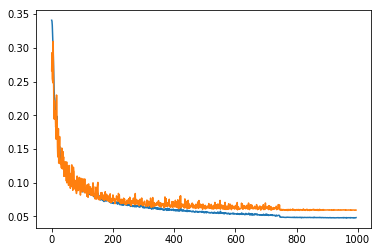

In [19]:
plt.plot(callback_list[1].history['train_loss'][5:])
plt.plot(callback_list[1].history['val_loss'][5:])

In [20]:
checkpoint = torch.load('../results/resnet/resnet-18-1c-nrmse.pth-best.tar')

## Loading the best model

In [21]:
from cpe775.utils.img_utils import show_landmarks_batch

In [22]:
net = resnet18(in_shape=(-1, 1, 224, 224), out_shape=(-1, 68, 2))

In [23]:
best_model = Model(net)
best_net = model.net
best_net.load_state_dict(checkpoint['state_dict'])

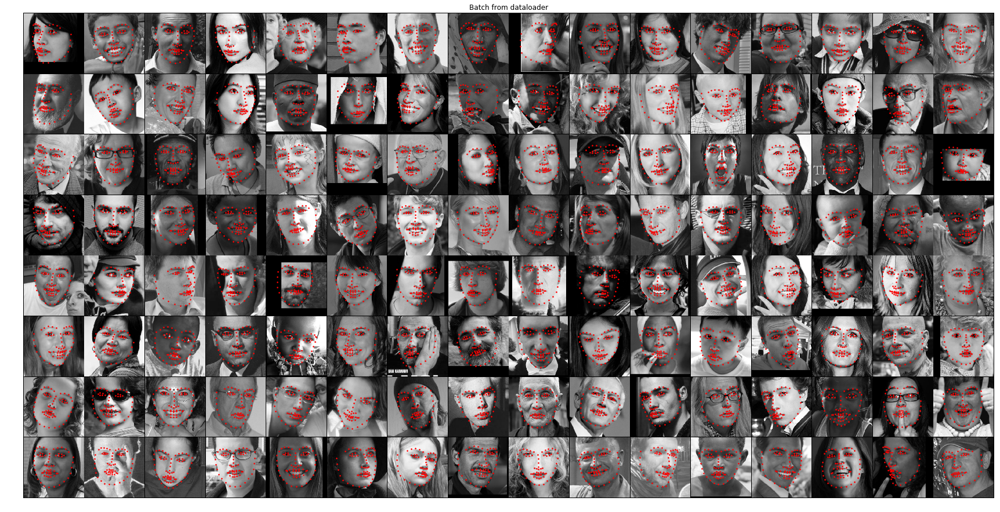

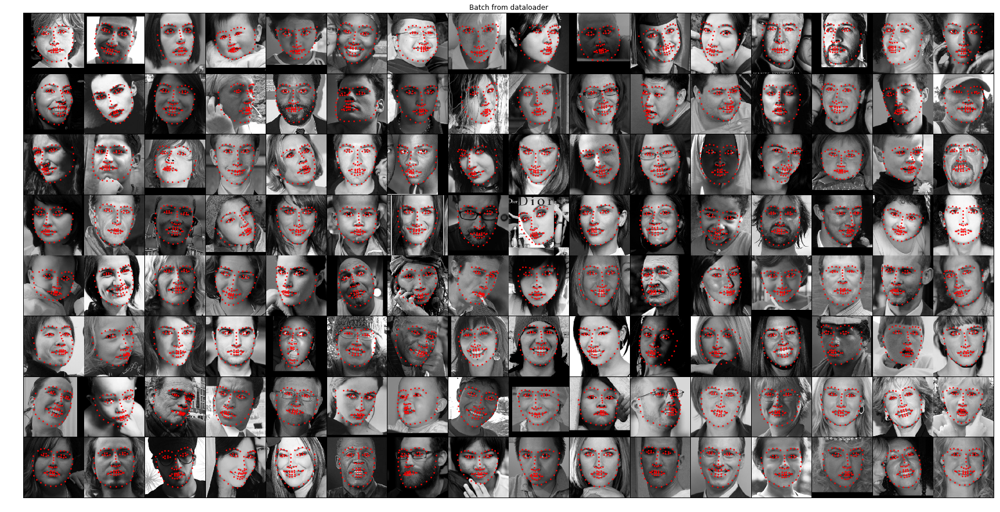

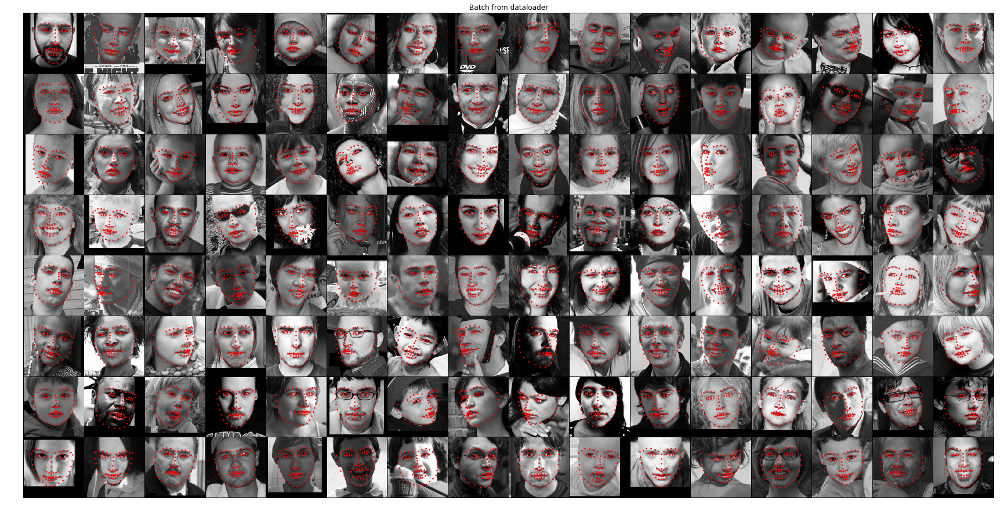

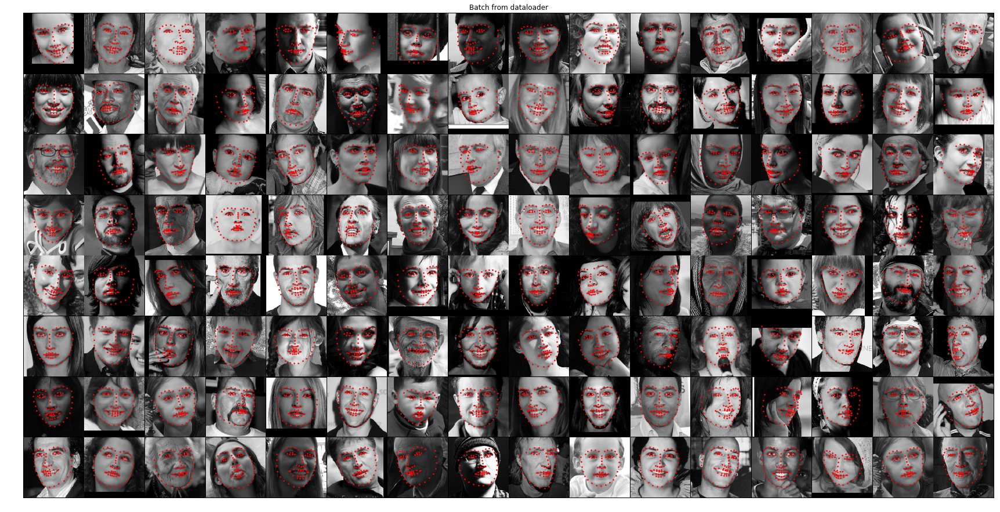

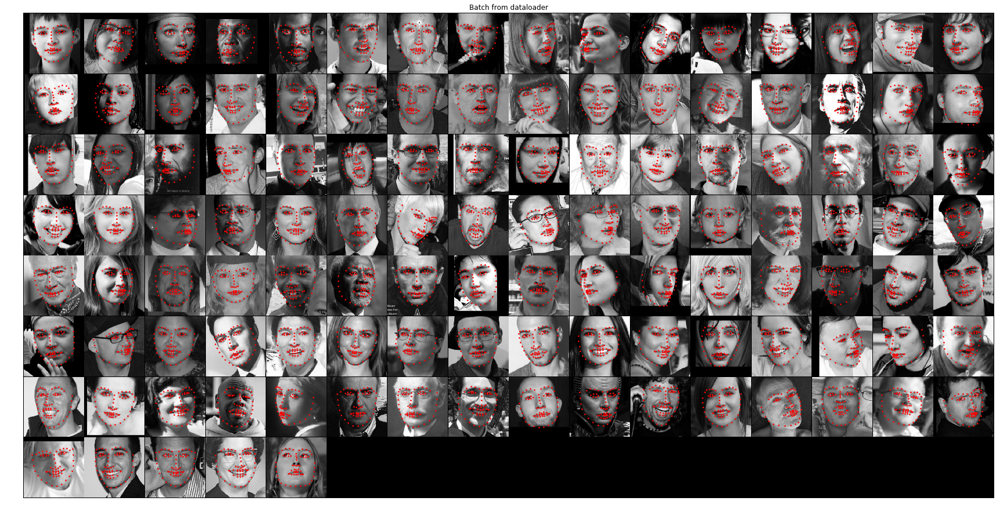

In [24]:
for i_batch, sample_batched in enumerate(valid_loader):
    
    predicted_landmarks = best_net(torch.autograd.Variable(sample_batched['image'], volatile=False)).cpu().data

    
    plt.figure(figsize=(30,18))
    show_landmarks_batch({'image': sample_batched['image'], 'landmarks': predicted_landmarks}, nrow=16)

    plt.axis('off')
    plt.ioff()
    plt.show()

### Common test

In [25]:
transforms = Compose([
                   CropFace(),
                   CenterCrop((224,224)),
                   ToGray(),
                   ToTensor()
                 ])

In [26]:
# load the dataset
dataset = FaceLandmarksDataset(csv_file='../data/common_test.csv',
                               root_dir='../data/',
                               transform=transforms)

common_loader = torch.utils.data.DataLoader(dataset, 
                batch_size=batch_size, num_workers=4)

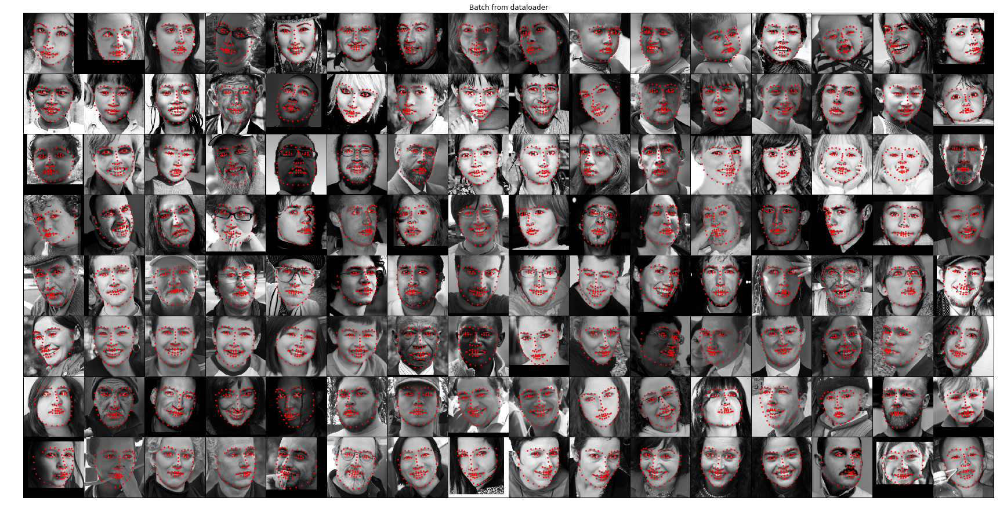

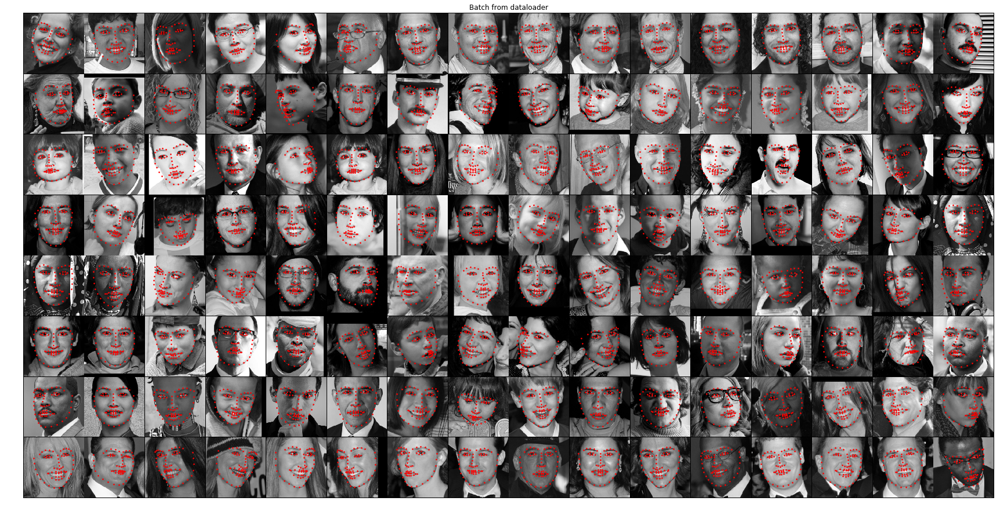

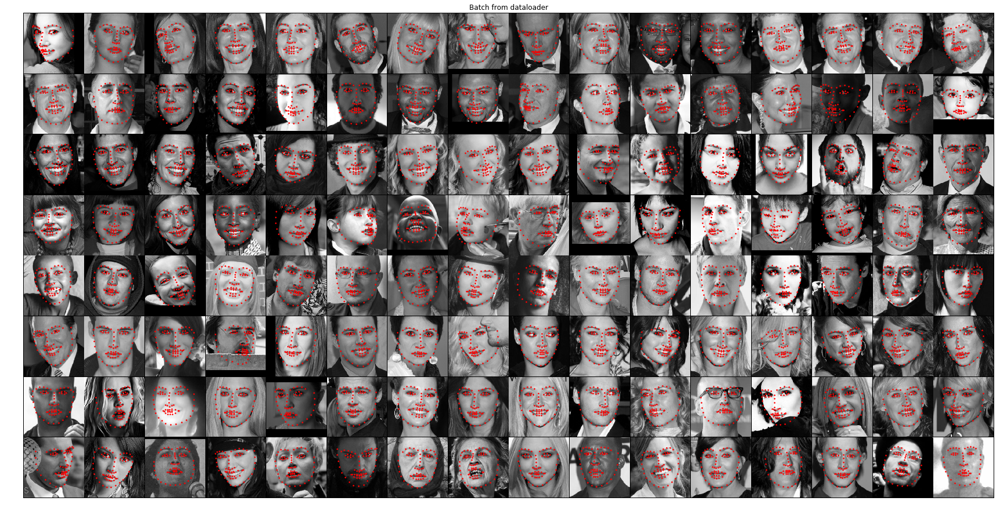

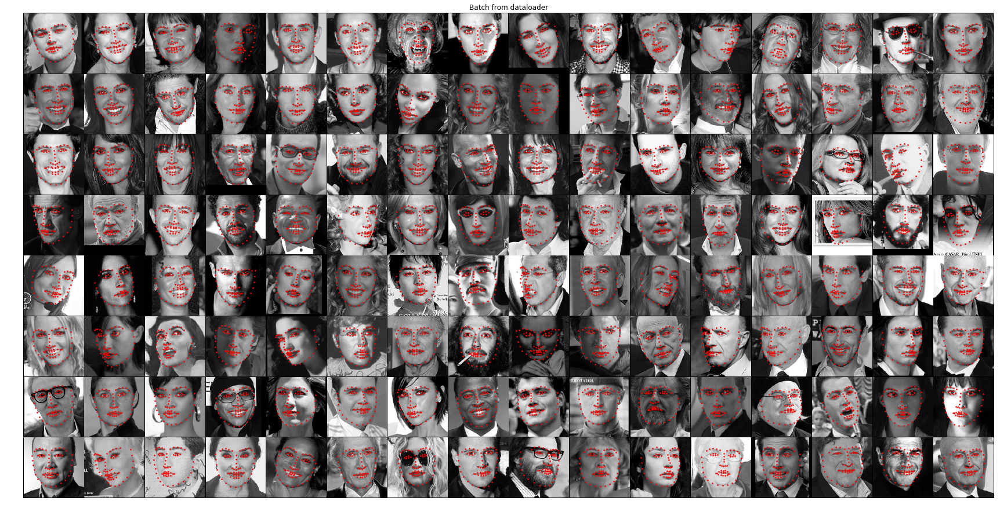

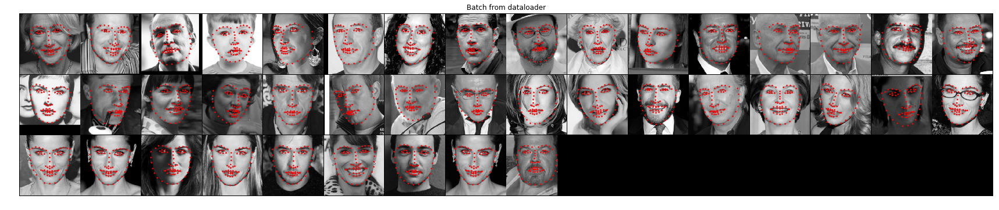

In [27]:
loss = 0
for i_batch, sample_batched in enumerate(common_loader):
    
    predicted_landmarks = best_net(torch.autograd.Variable(sample_batched['image'], volatile=False)).cpu().data
    
    loss += predicted_landmarks.shape[0]*criterion(predicted_landmarks, sample_batched['landmarks'])
    
    plt.figure(figsize=(30,18))
    show_landmarks_batch({'image': sample_batched['image'], 'landmarks': predicted_landmarks}, nrow=16)
    plt.axis('off')
    plt.ioff()
    plt.show()

In [28]:
loss/len(dataset)*68

3.7889304234769203

### Challenging test

In [29]:
# load the dataset
challenging_set = FaceLandmarksDataset(csv_file='../data/challenging_test.csv',
                               root_dir='../data/',
                               transform=transforms)

challeging_loader = torch.utils.data.DataLoader(challenging_set, 
                batch_size=batch_size, num_workers=4)

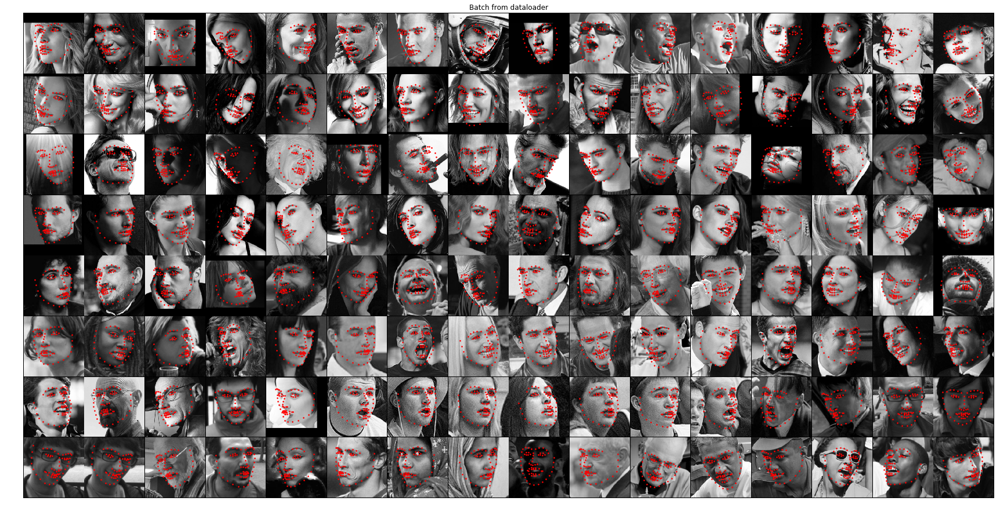

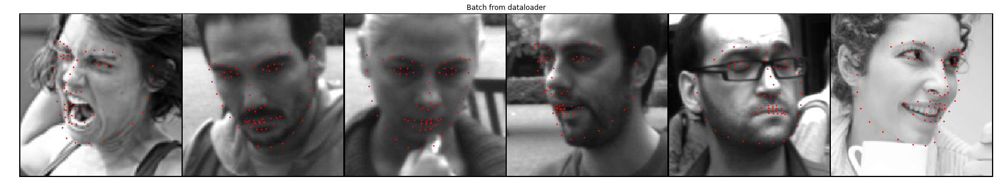

In [30]:
loss = 0
for i_batch, sample_batched in enumerate(challeging_loader):
    
    predicted_landmarks = best_net(torch.autograd.Variable(sample_batched['image'], volatile=False)).cpu().data
    
    loss += predicted_landmarks.shape[0]*criterion(predicted_landmarks, sample_batched['landmarks'])
    
    plt.figure(figsize=(30,18))
    show_landmarks_batch({'image': sample_batched['image'], 'landmarks': predicted_landmarks}, nrow=16)
    plt.axis('off')
    plt.ioff()
    plt.show()

In [31]:
loss/len(challenging_set)*68

8.389941032586703